In [201]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from datetime import datetime
from scipy.stats import skew  # for some statistics
from scipy.special import boxcox1p
from scipy.stats import boxcox_normmax
from sklearn.linear_model import ElasticNetCV, LassoCV, RidgeCV
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import RobustScaler
from sklearn.model_selection import KFold, cross_val_score
from sklearn.metrics import mean_squared_error
from mlxtend.regressor import StackingCVRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [216]:
train = pd.read_csv('/Users/feihuyan/Downloads/house/train.csv')
test = pd.read_csv('/Users/feihuyan/Downloads/house/test.csv')

In [138]:
list(train.columns)

['Id',
 'MSSubClass',
 'MSZoning',
 'LotFrontage',
 'LotArea',
 'Street',
 'Alley',
 'LotShape',
 'LandContour',
 'Utilities',
 'LotConfig',
 'LandSlope',
 'Neighborhood',
 'Condition1',
 'Condition2',
 'BldgType',
 'HouseStyle',
 'OverallQual',
 'OverallCond',
 'YearBuilt',
 'YearRemodAdd',
 'RoofStyle',
 'RoofMatl',
 'Exterior1st',
 'Exterior2nd',
 'MasVnrType',
 'MasVnrArea',
 'ExterQual',
 'ExterCond',
 'Foundation',
 'BsmtQual',
 'BsmtCond',
 'BsmtExposure',
 'BsmtFinType1',
 'BsmtFinSF1',
 'BsmtFinType2',
 'BsmtFinSF2',
 'BsmtUnfSF',
 'TotalBsmtSF',
 'Heating',
 'HeatingQC',
 'CentralAir',
 'Electrical',
 '1stFlrSF',
 '2ndFlrSF',
 'LowQualFinSF',
 'GrLivArea',
 'BsmtFullBath',
 'BsmtHalfBath',
 'FullBath',
 'HalfBath',
 'BedroomAbvGr',
 'KitchenAbvGr',
 'KitchenQual',
 'TotRmsAbvGrd',
 'Functional',
 'Fireplaces',
 'FireplaceQu',
 'GarageType',
 'GarageYrBlt',
 'GarageFinish',
 'GarageCars',
 'GarageArea',
 'GarageQual',
 'GarageCond',
 'PavedDrive',
 'WoodDeckSF',
 'OpenPorchSF'

In [139]:
train['SalePrice'].describe()

count      1460.000000
mean     180921.195890
std       79442.502883
min       34900.000000
25%      129975.000000
50%      163000.000000
75%      214000.000000
max      755000.000000
Name: SalePrice, dtype: float64

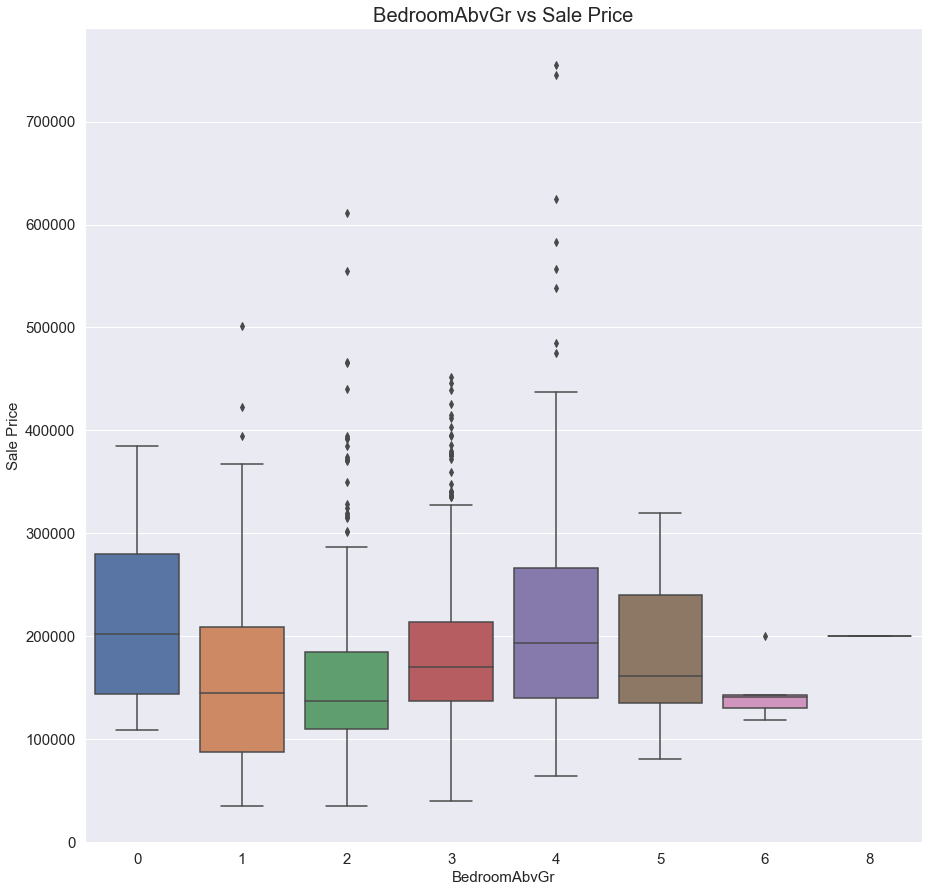

In [228]:
plt.figure(figsize=(15,15))
sns.boxplot(x=train['BedroomAbvGr'],y=train['SalePrice']).set_title('BedroomAbvGr vs Sale Price',fontsize=20)
plt.xlabel('BedroomAbvGr',fontsize=15)
plt.ylabel('Sale Price',fontsize=15)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.show()

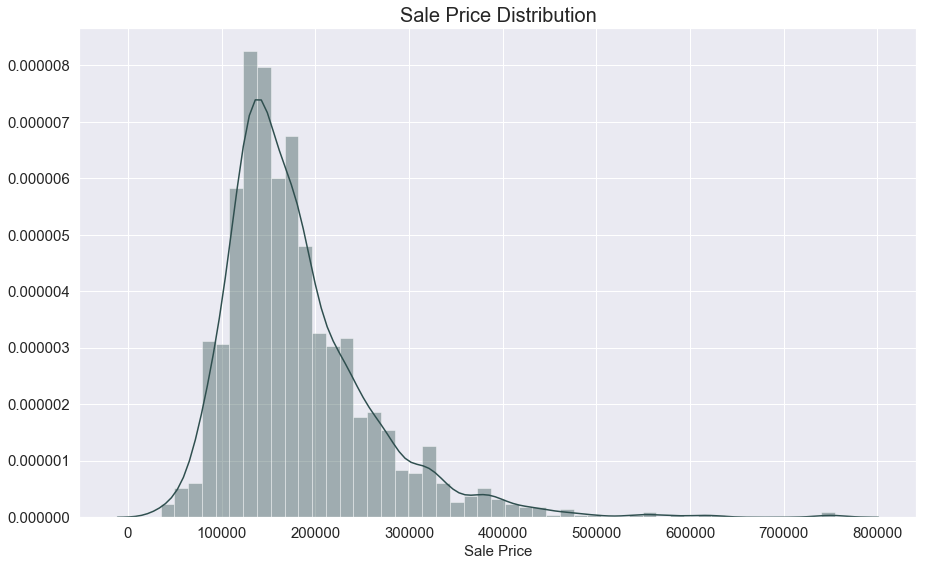

In [226]:
plt.figure(figsize=(15,9))
sns.distplot(train['SalePrice'],color='darkslategray').set_title('Sale Price Distribution',fontsize=20)
plt.xlabel('Sale Price',fontsize=15)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.show()

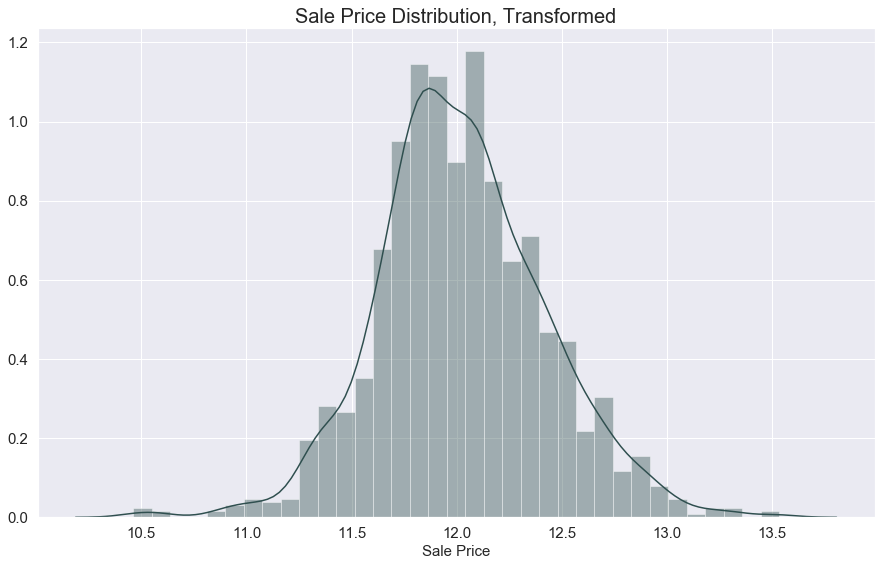

In [229]:
train["SalePrice"] = np.log1p(train["SalePrice"])
plt.figure(figsize=(15,9))
sns.distplot(train['SalePrice'],color='darkslategray').set_title('Sale Price Distribution, Transformed',fontsize=20)
plt.xlabel('Sale Price',fontsize=15)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.show()

In [142]:
train['SalePrice'].skew()

1.8828757597682129

In [143]:
train['SalePrice'].kurt()

6.536281860064529

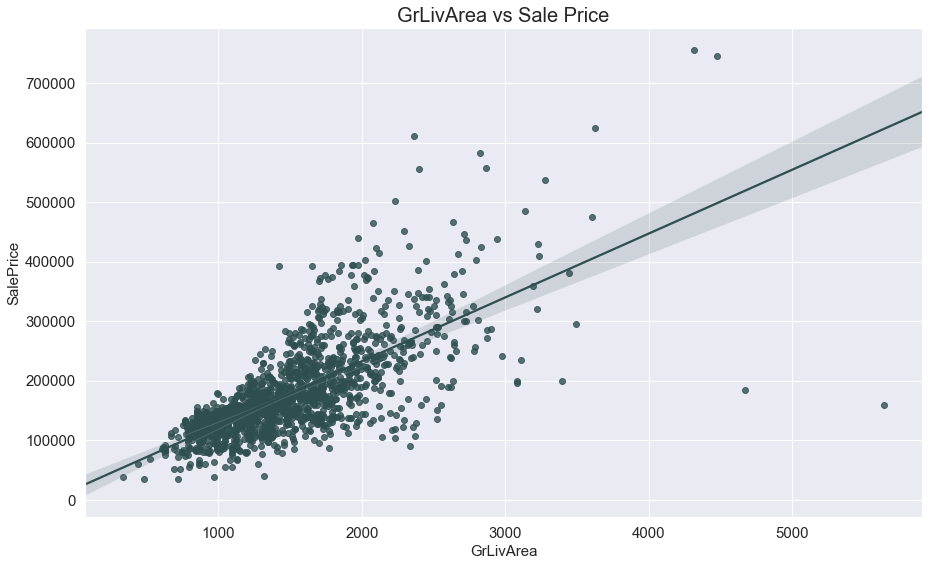

In [223]:
plt.figure(figsize=(15,9))
sns.regplot(train['GrLivArea'], train['SalePrice'],color='darkslategray').set_title('GrLivArea vs Sale Price', fontsize=20)
plt.xlabel('GrLivArea',fontsize=15)
plt.ylabel('SalePrice',fontsize=15)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.show()

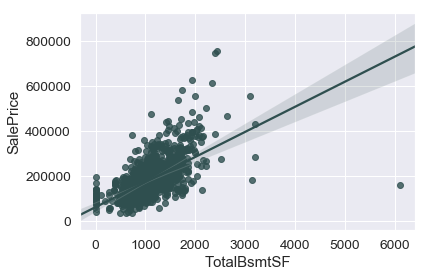

In [145]:
sns.regplot(train['TotalBsmtSF'], train['SalePrice'],color='darkslategray')

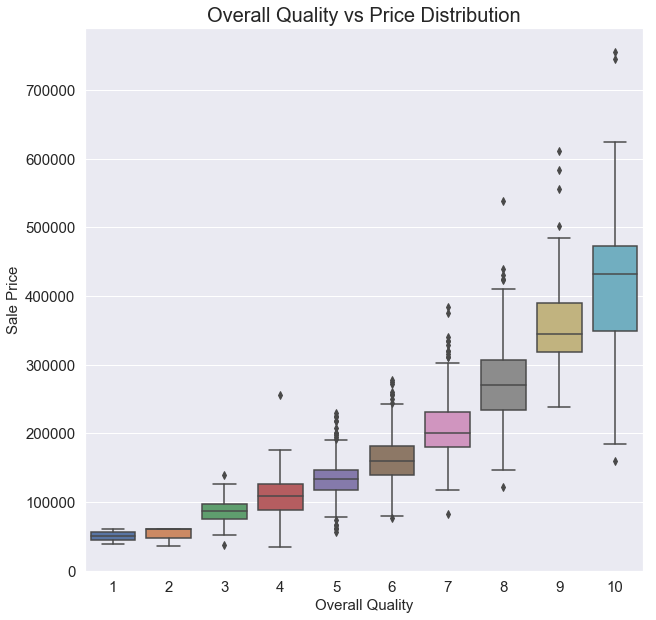

In [218]:
plt.figure(figsize=(10,10))
sns.boxplot(x=train['OverallQual'], y=train["SalePrice"]).set_title('Overall Quality vs Price Distribution', fontsize=20)
plt.xlabel("Overall Quality",fontsize=15)
plt.xticks(fontsize=15)
plt.ylabel("Sale Price",fontsize=15)
plt.yticks(fontsize=15);

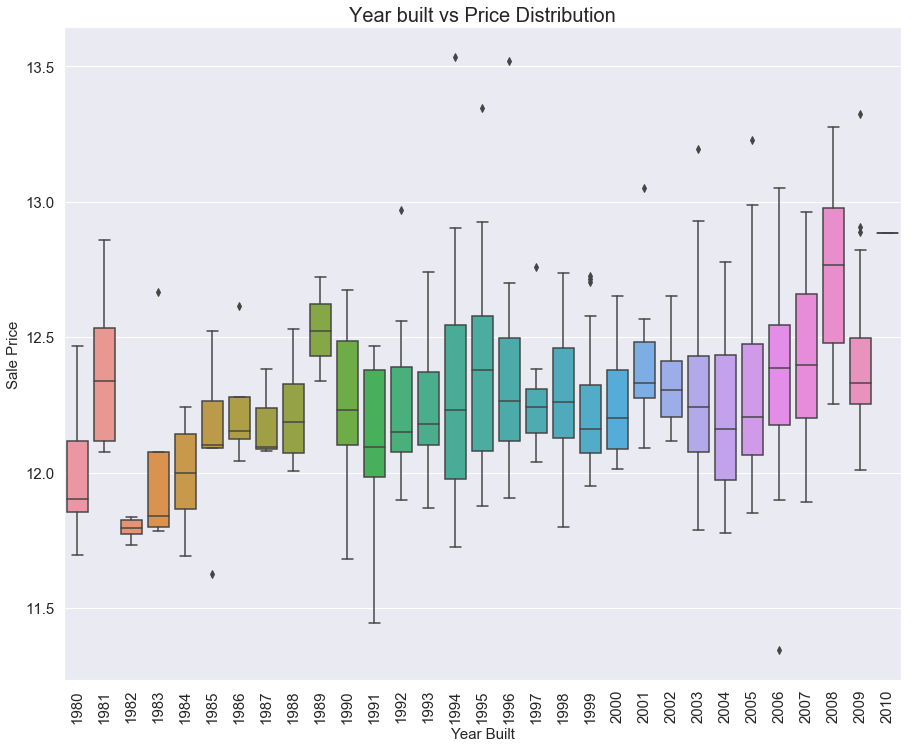

In [202]:
plt.figure(figsize=(15,12))
train1 = train[train['YearBuilt']>= 1980]
sns.boxplot(train1['YearBuilt'], y=train1["SalePrice"]).set_title('Year built vs Price Distribution', fontsize=20)
plt.xlabel("Year Built",fontsize=15)
plt.xticks(fontsize=15)
plt.ylabel("Sale Price",fontsize=15)
plt.yticks(fontsize=15)
plt.xticks(rotation=90);

In [148]:
#missing data
total = train.isnull().sum().sort_values(ascending=False)
percent = (train.isnull().sum()/train.isnull().count()).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_data.head(20)

,Total,Percent
PoolQC,1453,0.995205
MiscFeature,1406,0.963014
Alley,1369,0.937671
Fence,1179,0.807534
FireplaceQu,690,0.472603
LotFrontage,259,0.177397
GarageCond,81,0.055479
GarageType,81,0.055479
GarageYrBlt,81,0.055479
GarageFinish,81,0.055479


In [209]:
mi

PoolQC          1453
MiscFeature     1406
Alley           1369
Fence           1179
FireplaceQu      690
LotFrontage      259
GarageCond        81
GarageType        81
GarageYrBlt       81
GarageFinish      81
GarageQual        81
BsmtExposure      38
BsmtFinType2      38
BsmtFinType1      37
BsmtCond          37
BsmtQual          37
MasVnrArea         8
MasVnrType         8
Electrical         1
Utilities          0
Name: Total, dtype: int64

Text(0.5, 1.0, 'Missing Data')

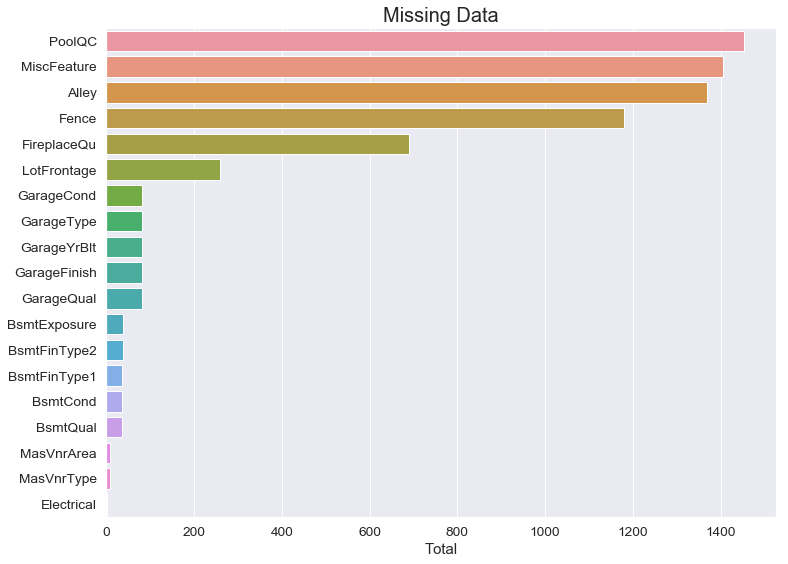

In [214]:
mi = pd.DataFrame(missing_data['Total'][:19])
plt.figure(figsize=(12,9))
sns.barplot(x=mi['Total'], y=mi.index).set_title('Missing Data', fontsize=20)

In [149]:
train.sort_values(by = 'GrLivArea', ascending = False)[:2]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1298,1299,60,RL,313.0,63887,Pave,NaN,IR3,Bnk,AllPub,Corner,Gtl,Edwards,Feedr,Norm,1Fam,2Story,10,5,2008,2008,Hip,ClyTile,Stucco,Stucco,Stone,796.0,Ex,TA,PConc,Ex,TA,Gd,GLQ,5644,Unf,0,466,6110,GasA,Ex,Y,SBrkr,4692,950,0,5642,2,0,2,1,3,1,Ex,12,Typ,3,Gd,Attchd,2008.0,Fin,2,1418,TA,TA,Y,214,292,0,0,0,480,Gd,NaN,NaN,0,1,2008,New,Partial,160000
523,524,60,RL,130.0,40094,Pave,NaN,IR1,Bnk,AllPub,Inside,Gtl,Edwards,PosN,PosN,1Fam,2Story,10,5,2007,2008,Hip,CompShg,CemntBd,CmentBd,Stone,762.0,Ex,TA,PConc,Ex,TA,Gd,GLQ,2260,Unf,0,878,3138,GasA,Ex,Y,SBrkr,3138,1538,0,4676,1,0,3,1,3,1,Ex,11,Typ,1,Gd,BuiltIn,2007.0,Fin,3,884,TA,TA,Y,208,406,0,0,0,0,NaN,NaN,NaN,0,10,2007,New,Partial,184750


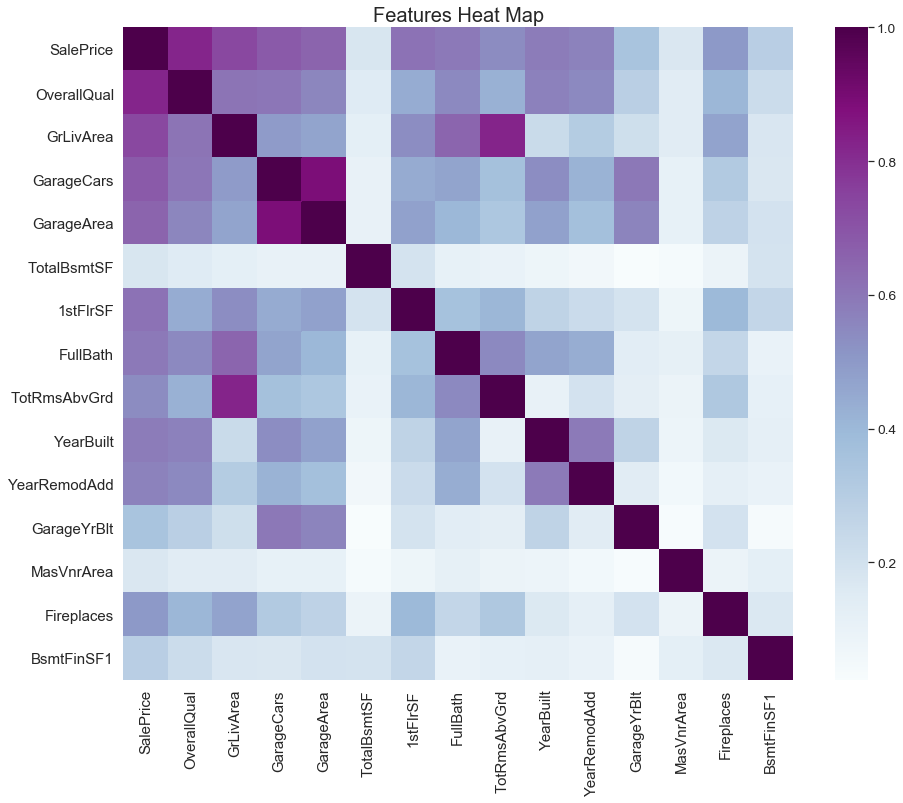

In [195]:
#saleprice correlation matrix
k = 15 
cols = corrmat.nlargest(k, 'SalePrice')['SalePrice'].index
cm = np.corrcoef(train[cols].values.T)
plt.figure(figsize=(15,12))
sns.set(font_scale=1.25)
sns.heatmap(cm, cmap='BuPu', cbar=True, fmt='.2', annot_kws={'size': 10}, yticklabels=cols.values, xticklabels=cols.values).set_title('Features Heat Map', fontsize=20)

plt.xticks(fontsize=15)
plt.yticks(fontsize=15)

plt.show()

In [193]:
train = train.drop(train[train['Id'] == 1299].index)
train = train.drop(train[train['Id'] == 524].index)
train.drop(['Id'], axis=1, inplace=True)
test.drop(['Id'], axis=1, inplace=True)
train = train[train.GrLivArea < 4500]
train.reset_index(drop=True, inplace=True)
train["SalePrice"] = np.log1p(train["SalePrice"])
train['SalePrice'].reset_index(drop=True, inplace=True)

KeyError: 'Id'

In [152]:
def data_cleaning(df):
    df['MSSubClass'] = df['MSSubClass'].apply(str)
    df['YrSold'] = df['YrSold'].astype(str)
    df['MoSold'] = df['MoSold'].astype(str)
    df['Functional'] = df['Functional'].fillna('Typ') 
    df['Electrical'] = df['Electrical'].fillna("SBrkr") 
    df['KitchenQual'] = df['KitchenQual'].fillna("TA") 
    df["PoolQC"] = df["PoolQC"].fillna("None")
    df['Exterior1st'] = df['Exterior1st'].fillna(df['Exterior1st'].mode()[0]) 
    df['Exterior2nd'] = df['Exterior2nd'].fillna(df['Exterior2nd'].mode()[0])
    df['SaleType'] = df['SaleType'].fillna(df['SaleType'].mode()[0])
    df['MSZoning'] = df.groupby('MSSubClass')['MSZoning'].transform(lambda x: x.fillna(x.mode()[0]))
    df['LotFrontage'] = df.groupby('Neighborhood')['LotFrontage'].transform(lambda x: x.fillna(x.median()))
    for col in ('GarageYrBlt', 'GarageArea', 'GarageCars'):
        df[col] = df[col].fillna(0)
    for col in ['GarageType', 'GarageFinish', 'GarageQual', 'GarageCond','BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2']:
        df[col] = df[col].fillna('None')

In [153]:
data_cleaning(train)
data_cleaning(test)

In [154]:
objects = []
for i in train.columns:
    if train[i].dtype == object:
        objects.append(i)
train.update(train[objects].fillna('None'))
test.update(test[objects].fillna('None'))
numeric_dtypes = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
numerics = []
for i in train.columns:
    if train[i].dtype in numeric_dtypes:
        numerics.append(i)
train.update(train[numerics].fillna(0))
test.update(test[objects].fillna('None'))

In [167]:
numeric_dtypes = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
numerics = []
for i in train.columns:
    if train[i].dtype in numeric_dtypes:
        numerics.append(i)
skew_features = train[numerics].apply(lambda x: skew(x)).sort_values(ascending=False)

high_skew = skew_features[skew_features > 0.5]
skew_index = high_skew.index

for i in skew_index:
    train[i] = boxcox1p(train[i], boxcox_normmax(train[i] + 1))
    train[i] = boxcox1p(train[i], boxcox_normmax(test[i] + 1))

In [168]:
train.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Alley,LotShape,LandContour,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice,YrBltAndRemod,TotalSF,Total_sqr_footage,Total_Bathrooms,Total_porch_sf,haspool,has2ndfloor,hasgarage,hasbsmt,hasfireplace
0,60,RL,8.177707,3.291004,None,Reg,Lvl,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,2.961267,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,1.498159e+10,Gd,TA,PConc,Gd,TA,No,GLQ,2.487444e+18,Unf,0.0,5.481211e+11,1.272464e+22,GasA,Ex,Y,SBrkr,1.903984,1217.609804,0.0,2.347655,40.827432,0.000000,2,1.135375,3,0.598104,Gd,1.187458,Typ,0.000000,None,Attchd,2003.0,RFn,2,548,TA,TA,Y,0.000000,4.848434,0.000000,0.0,0.0,0.0,None,None,0.0,2,2008,WD,Normal,12.247699,4006,1.812891e+13,1.154061e+09,3.5,8.529233,0.0,1,1,1,0
1,20,RL,8.935514,3.315686,None,Reg,Lvl,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,4.112786,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.000000e+00,TA,TA,CBlock,Gd,TA,Gd,ALQ,2.021364e+19,Unf,0.0,1.342232e+13,2.560939e+23,GasA,Ex,Y,SBrkr,1.945798,0.000000,0.0,2.300358,0.000000,9.580183,2,0.000000,3,0.598104,TA,1.101246,Typ,0.820238,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,18.743642,0.000000,0.000000,0.0,0.0,0.0,None,None,0.0,5,2007,WD,Normal,12.109016,3952,1.718662e+13,1.017097e+09,2.5,16.912818,0.0,0,1,1,1
2,60,RL,8.337753,3.346057,None,IR1,Lvl,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,2.961267,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,7.291955e+09,Gd,TA,PConc,Gd,TA,Mn,GLQ,2.255639e+17,Unf,0.0,1.116238e+14,2.222181e+22,GasA,Ex,Y,SBrkr,1.911919,1235.766555,0.0,2.354325,40.827432,0.000000,2,1.135375,3,0.598104,Gd,1.101246,Typ,0.820238,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0.000000,4.291278,0.000000,0.0,0.0,0.0,None,None,0.0,9,2008,WD,Normal,12.317171,4003,2.152570e+13,1.041525e+09,3.5,7.183097,0.0,1,1,1,1
3,70,RL,7.899907,3.314680,None,IR1,Lvl,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,2.961267,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.000000e+00,TA,TA,BrkTil,TA,Gd,No,ALQ,1.230357e+15,Unf,0.0,3.319313e+14,4.869760e+21,GasA,Gd,Y,SBrkr,1.916679,1069.932536,0.0,2.348283,40.827432,0.000000,1,0.000000,3,0.598104,Gd,1.147850,Typ,0.820238,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0.000000,4.033486,4.840909,0.0,0.0,0.0,None,None,0.0,2,2006,WD,Abnorml,11.849405,3885,1.608832e+13,7.938698e+08,2.0,17.122497,0.0,1,1,1,1
4,60,RL,9.121663,3.390838,None,IR1,Lvl,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,2.961267,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,1.315662e+11,Gd,TA,PConc,Gd,TA,Av,GLQ,1.536086e+18,Unf,0.0,2.044865e+14,1.206679e+23,GasA,Ex,Y,SBrkr,1.935523,1520.583092,0.0,2.385828,40.827432,0.000000,2,1.135375,4,0.598104,Gd,1.221786,Typ,0.820238,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,15.461547,5.359270,0.000000,0.0,0.0,0.0,None,None,0.0,12,2008,WD,Normal,12.429220,4000,4.258646e+13,1.520597e+09,3.5,16.382989,0.0,1,1,1,1


In [161]:
train.drop(['Utilities', 'Street', 'PoolQC'], axis=1, inplace=True)
test.drop(['Utilities', 'Street', 'PoolQC'], axis=1, inplace=True)

In [162]:
def data_eng(df):   
    df['YrBltAndRemod']=df['YearBuilt']+df['YearRemodAdd']
    df['TotalSF']=df['TotalBsmtSF'] + df['1stFlrSF'] + df['2ndFlrSF']
    df['Total_sqr_footage'] = (df['BsmtFinSF1'] + df['BsmtFinSF2'] +
                                     df['1stFlrSF'] + df['2ndFlrSF'])
    df['Total_Bathrooms'] = (df['FullBath'] + (0.5 * df['HalfBath']) +
                                   df['BsmtFullBath'] + (0.5 * df['BsmtHalfBath']))
    df['Total_porch_sf'] = (df['OpenPorchSF'] + df['3SsnPorch'] +
                                  df['EnclosedPorch'] + df['ScreenPorch'] +
                                  df['WoodDeckSF'])
    df['haspool'] = df['PoolArea'].apply(lambda x: 1 if x > 0 else 0)
    df['has2ndfloor'] = df['2ndFlrSF'].apply(lambda x: 1 if x > 0 else 0)
    df['hasgarage'] = df['GarageArea'].apply(lambda x: 1 if x > 0 else 0)
    df['hasbsmt'] = df['TotalBsmtSF'].apply(lambda x: 1 if x > 0 else 0)
    df['hasfireplace'] = df['Fireplaces'].apply(lambda x: 1 if x > 0 else 0)

In [163]:
data_eng(train)
data_eng(test)

In [164]:
train_df = pd.get_dummies(train).reset_index(drop=True)
test_df = pd.get_dummies(test).reset_index(drop=True)

In [171]:
y = train['SalePrice'].reset_index(drop=True)

In [172]:
train_df

,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,SalePrice,YrBltAndRemod,TotalSF,Total_sqr_footage,Total_Bathrooms,Total_porch_sf,haspool,has2ndfloor,hasgarage,hasbsmt,hasfireplace,MSSubClass_120,MSSubClass_160,MSSubClass_180,MSSubClass_190,MSSubClass_20,MSSubClass_30,MSSubClass_40,MSSubClass_45,MSSubClass_50,MSSubClass_60,MSSubClass_70,MSSubClass_75,MSSubClass_80,MSSubClass_85,MSSubClass_90,MSZoning_C (all),MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Alley_Grvl,Alley_None,Alley_Pave,LotShape_IR1,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_Bnk,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_Corner,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Gtl,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blmngtn,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Artery,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Artery,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_1Fam,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Fin,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Flat,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsbShng,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsbShng,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkCmn,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Ex,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Ex,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_BrkTil,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Ex,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_None,BsmtQual_TA,BsmtCond_Fa,BsmtCond_Gd,BsmtCond_None,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Av,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtExposure_None,BsmtFinType1_ALQ,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_None,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_ALQ,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_None,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_Floor,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Ex,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_N,CentralAir_Y,Electrical_FuseA,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Ex,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj1,Functional_Maj2,Functional_Min1,Functional_Min2,Funct

In [173]:
kfolds = KFold(n_splits=10, shuffle=True, random_state=42)

def rmsle(y, y_pred):
    return np.sqrt(mean_squared_error(y, y_pred))

def cv_rmse(model, X=train_df):
    rmse = np.sqrt(-cross_val_score(model, X, y, scoring="neg_mean_squared_error", cv=kfolds))
    return (rmse)

In [174]:
ridge = make_pipeline(RobustScaler(), RidgeCV(alphas=[14.5, 14.6, 14.7, 14.8, 14.9, 15, 15.1, 15.2, 15.3, 15.4, 15.5], cv=kfolds))
lasso = make_pipeline(RobustScaler(), LassoCV(max_iter=1e7, alphas=[0.0001, 0.0002, 0.0003, 0.0004, 0.0005, 0.0006, 0.0007, 0.0008], random_state=42, cv=kfolds))
elasticnet = make_pipeline(RobustScaler(), ElasticNetCV(max_iter=1e7, alphas=[0.0001, 0.0002, 0.0003, 0.0004, 0.0005, 0.0006, 0.0007], cv=kfolds, l1_ratio=[0.8, 0.85, 0.9, 0.95, 0.99, 1]))                                
svr = make_pipeline(RobustScaler(), SVR(C= 20, epsilon= 0.008, gamma=0.0003,))

In [177]:
gbr = GradientBoostingRegressor(n_estimators=3000, 
                                learning_rate=0.07, 
                                max_depth=5, 
                                max_features='sqrt', 
                                min_samples_leaf=15, 
                                min_samples_split=10, 
                                loss='huber', 
                                random_state =42)
lightgbm = LGBMRegressor(objective='regression', 
                           num_leaves=5,
                           learning_rate=0.02, 
                           n_estimators=5000,
                           max_bin=200, 
                           bagging_fraction=0.75,
                           bagging_freq=5, 
                           bagging_seed=7,
                           feature_fraction=0.2,
                           feature_fraction_seed=7,
                           verbose=-1,
                           )

In [185]:
stack_gen = StackingCVRegressor(regressors=(ridge, lasso, elasticnet, gbr, svr),
                                meta_regressor=lightgbm,
                                use_features_in_secondary=True)

In [180]:
score = cv_rmse(ridge , train_df)
score = cv_rmse(lasso , train_df)
score = cv_rmse(elasticnet)
print("elastic net: {:.4f} ({:.4f})\n".format(score.mean(), score.std()), datetime.now(), )

score = cv_rmse(svr)
print("SVR: {:.4f} ({:.4f})\n".format(score.mean(), score.std()), datetime.now(), )

score = cv_rmse(lightgbm)
print("lightgbm: {:.4f} ({:.4f})\n".format(score.mean(), score.std()), datetime.now(), )

score = cv_rmse(gbr)
print("gbr: {:.4f} ({:.4f})\n".format(score.mean(), score.std()), datetime.now(), )

LASSO: 0.0001 (0.0000)
 2020-07-19 20:46:11.622539
elastic net: 0.0001 (0.0000)
 2020-07-19 20:46:17.873481
SVR: 0.1493 (0.0199)
 2020-07-19 20:46:24.281621
lightgbm: 0.0595 (0.0133)
 2020-07-19 20:46:36.133743
gbr: 0.0707 (0.0100)
 2020-07-19 20:47:59.781880


In [187]:
stack_gen_m = stack_gen.fit(np.array(train_df), np.array(y))
elastic_model = elasticnet.fit(train_df, y)
lasso_model = lasso.fit(train_df, y)
ridge_model = ridge.fit(train_df, y)
svr_model = svr.fit(train_df, y)
gbr_model = gbr.fit(train_df, y)
lgb_model = lightgbm.fit(train_df, y)

In [188]:
def blend_models_predict(X):
    return ((0.1 * elastic_model.predict(X)) + \
            (0.05 * lasso_model.predict(X)) + \
            (0.1 * ridge_model.predict(X)) + \
            (0.1 * svr_model.predict(X)) + \
            (0.15 * gbr_model.predict(X)) + \
            (0.2 * lgb_model.predict(X)) + \
            (0.3 * stack_gen_m.predict(np.array(X))))

In [189]:
print('RMSLE score on train data:')
print(rmsle(y, blend_models_predict(train_df)))

RMSLE score on train data:
0.01142893557467091
